In [8]:
import os
import sys
import pickle
sys.path.append("..") # Adds higher directory to python modules path.

import cv2
from tqdm.auto import tqdm

from utils.reading import read_annotations_from_txt

import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import cv2

%matplotlib inline

In [2]:
repo_path = os.path.abspath('')
repo_path = os.path.abspath(os.path.join(os.getcwd(),"../.."))

dataset_path = os.path.join(repo_path, 'datasets', 'aic19-track1-mtmc-train')
train_path = os.path.join(dataset_path, 'train')
train_sequences = ['S01', 'S04']      # Train with S01 and S04
test_path = os.path.join(dataset_path, 'train', 'S03')
test_cameras = ['c010', 'c011', 'c012', 'c013', 'c014', 'c015']
#test_cameras = ['c010']

In [3]:
def create_folder(path):
    if not os.path.exists(path):
        os.makedirs(path)

In [61]:
for sequence in train_sequences:
    print(sequence)
    sequence_path = os.path.join(train_path, sequence)
    cameras = [f for f in os.listdir(sequence_path) if not f.startswith('.')]

    for camera in cameras:
        print(camera)
        # Load video
        video_path = os.path.join(sequence_path, camera, 'vdo.avi')

        # Read groundtruth
        gt_path = os.path.join(sequence_path, camera, 'gt', 'gt.txt')
        groundtruth_list = read_annotations_from_txt(gt_path)

        # Load frames
        capture = cv2.VideoCapture(video_path)
        pbar = tqdm(total=int(capture.get(cv2.CAP_PROP_FRAME_COUNT)))
        while capture.isOpened():
            valid, frame = capture.read()
            if not valid:
                break

            # Load bboxes on this frame
            gt_on_frame = [x for x in groundtruth_list if x.frame == int(capture.get(cv2.CAP_PROP_POS_FRAMES))-1]

            for detection in gt_on_frame:            
                # Check and create track_id folder
                detection_path = os.path.join(repo_path, 'datasets', 'siamese_cars', str(detection.track_id))
                create_folder(detection_path)

                # Create crop
                crop_image = frame[detection.bbox[1]:detection.bbox[3], detection.bbox[0]:detection.bbox[2]]
                
                # TODO: resize
                resize_image = cv2.resize(crop_image,(64,64))
                
                # Save crop in folder
                cv2.imwrite(os.path.join(detection_path, "{}_{}_{:04d}-{:04d}.jpg".format(sequence, camera, detection.track_id, detection.frame)), resize_image)                
                #cv2.imshow("cropped", crop_img)
                #cv2.waitKey(0)

            pbar.update(1)
        pbar.close()


# Estudiar dataset

In [14]:
from glob import glob
import pandas as pd
import cv2
from PIL import Image


In [15]:
dataset_path = os.path.join(repo_path, 'datasets', 'siamese_cars')

clase_list = []
length_list = []
images_list = []
height_list = []
width_list = []

for clase in [f for f in os.listdir(dataset_path) if not f.startswith('.')]:
    print(clase)
    clase_list.append(clase)
    
    images_list = os.listdir(os.path.join(dataset_path, clase))
    length_list.append(len(images_list))


In [16]:
images_list

In [17]:
d = {'name': images_list, 'height': height_list, 'width': width_list}
df = pd.DataFrame(data=d)
df

In [18]:
d = {'Clase': clase_list, 'Samples': length_list}
df = pd.DataFrame(data=d)
df

# Calibration

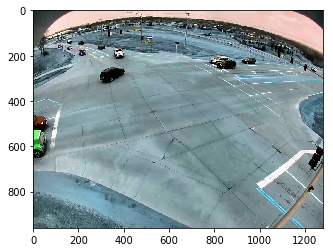

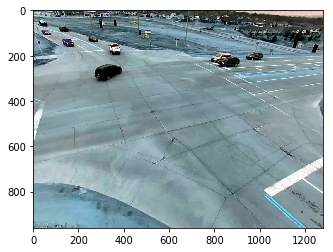

In [55]:
def get_undistort_matrices(calibration_path):
    # Load calibration 
    f = open(calibration_path, "r")

    # Not necessary
    f.readline()

    # Camera matrix
    line = f.readline()
    line_split = line.split()
    camera_matrix = np.array([[line_split[3], line_split[4], line_split[5].split(";")[0]],[line_split[5].split(";")[1], line_split[6], line_split[7].split(";")[0]],[line_split[7].split(";")[1], line_split[8], line_split[9]]], dtype=np.float64)
    #print(camera_matrix)

    # Distort coefficients
    line = f.readline()
    line_split = line.split()
    distort_coef = np.array([line_split[2], line_split[3], line_split[4], line_split[5]], dtype=np.float64)
    #print(distort_coef)

    f.close()
    
    return camera_matrix, distort_coef
    
calibration_video = os.path.join(train_path, 'S01', 'c005', 'vdo.avi')
calibration_path = "calibration.txt"

camera_matrix, distort_coef = get_undistort_matrices(calibration_path)

# Load one image
capture = cv2.VideoCapture(calibration_video)
while capture.isOpened():
    valid, frame = capture.read()
    if not valid:
        break
    break    
    
plt.imshow(frame)
plt.show()

dst = cv2.undistort(frame, camera_matrix, distort_coef, None, None)

plt.imshow(dst)
plt.show()


In [16]:
calibration_video = os.path.join(train_path, 'S01', 'c005', 'vdo.avi')
calibration_path = "calibration.txt"

# Load calibration 
f = open(calibration_path, "r")

# Not necessary
f.readline()

# Camera matrix
line = f.readline()
line_split = line.split()
camera_matrix = np.array([[line_split[3], line_split[4], line_split[5].split(";")[0]],[line_split[5].split(";")[1], line_split[6], line_split[7].split(";")[0]],[line_split[7].split(";")[1], line_split[8], line_split[9]]], dtype=np.float64)
camera_matrix_2 = np.array([[float(line_split[3])/2, line_split[4], line_split[5].split(";")[0]],[line_split[5].split(";")[1], float(line_split[6])/2, line_split[7].split(";")[0]],[line_split[7].split(";")[1], line_split[8], line_split[9]]], dtype=np.float64)
print(camera_matrix)

# Distort coefficients
line = f.readline()
line_split = line.split()
distort_coef = np.array([line_split[2], line_split[3], line_split[4], line_split[5]], dtype=np.float64)
print(distort_coef)

f.close()

[[1.28e+03 0.00e+00 6.40e+02]
 [0.00e+00 1.28e+03 4.80e+02]
 [0.00e+00 0.00e+00 1.00e+00]]
[-0.60000002  0.          0.          0.        ]


In [17]:
# Load one image
capture = cv2.VideoCapture(calibration_video)
while capture.isOpened():
    valid, frame = capture.read()
    if not valid:
        break
    break
    

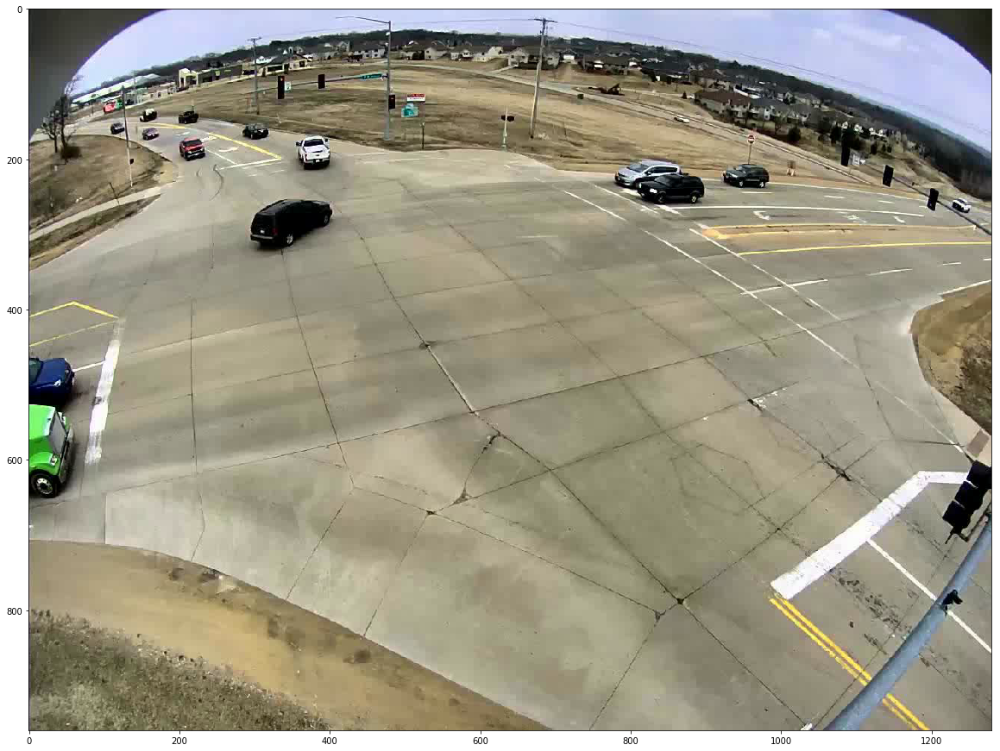

In [35]:

fig, ax = plt.subplots(figsize=(20,30))
ax.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))

minc = 295.031
minr = 252.479 
maxc = minc + 111.785
maxr = minr + 68.932

rect = mpatches.Rectangle((minc, minr), maxc - minc + 1, maxr - minr + 1, fill=False, edgecolor='red', linewidth=2)
#ax.add_patch(rect)

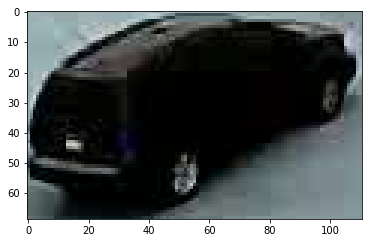

In [27]:
crop_image = frame[int(minr):int(maxr),int(minc):int(maxc)]
plt.imshow(crop_image)

In [20]:
dst = cv2.undistort(frame, camera_matrix, distort_coef, None, None)

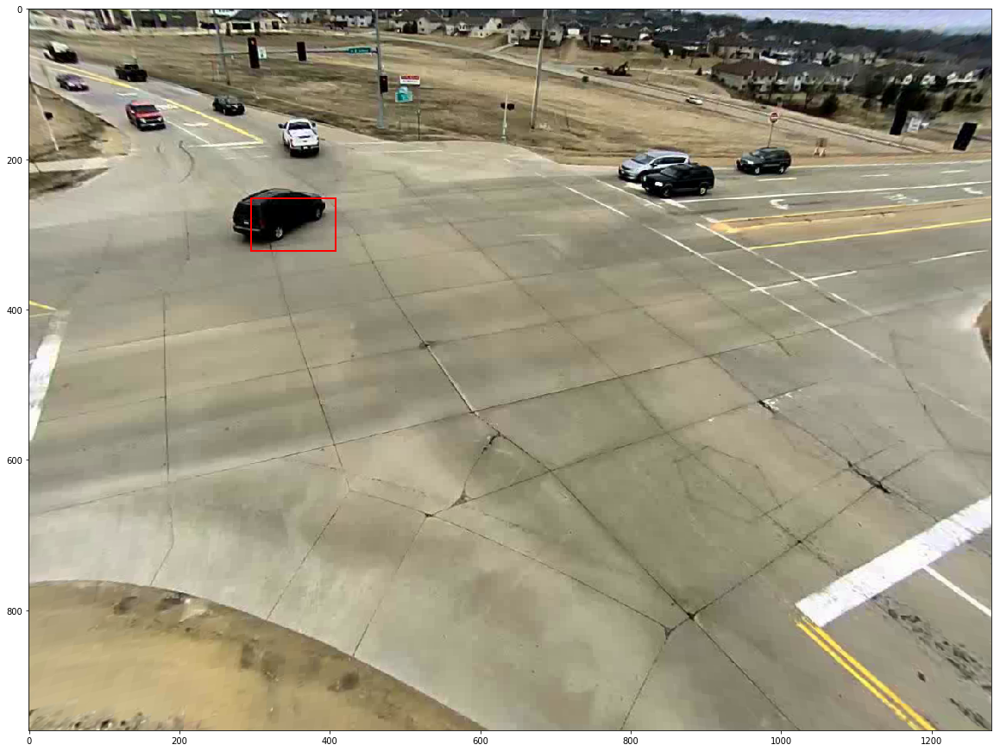

In [34]:
fig, ax = plt.subplots(figsize=(20,30))
ax.imshow(cv2.cvtColor(dst, cv2.COLOR_BGR2RGB))

rect = mpatches.Rectangle((minc, minr), maxc - minc + 1, maxr - minr + 1, fill=False, edgecolor='red', linewidth=2)
ax.add_patch(rect)

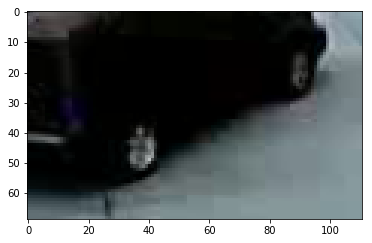

In [22]:
crop_image = dst[int(minr):int(maxr),int(minc):int(maxc)]
plt.imshow(crop_image)

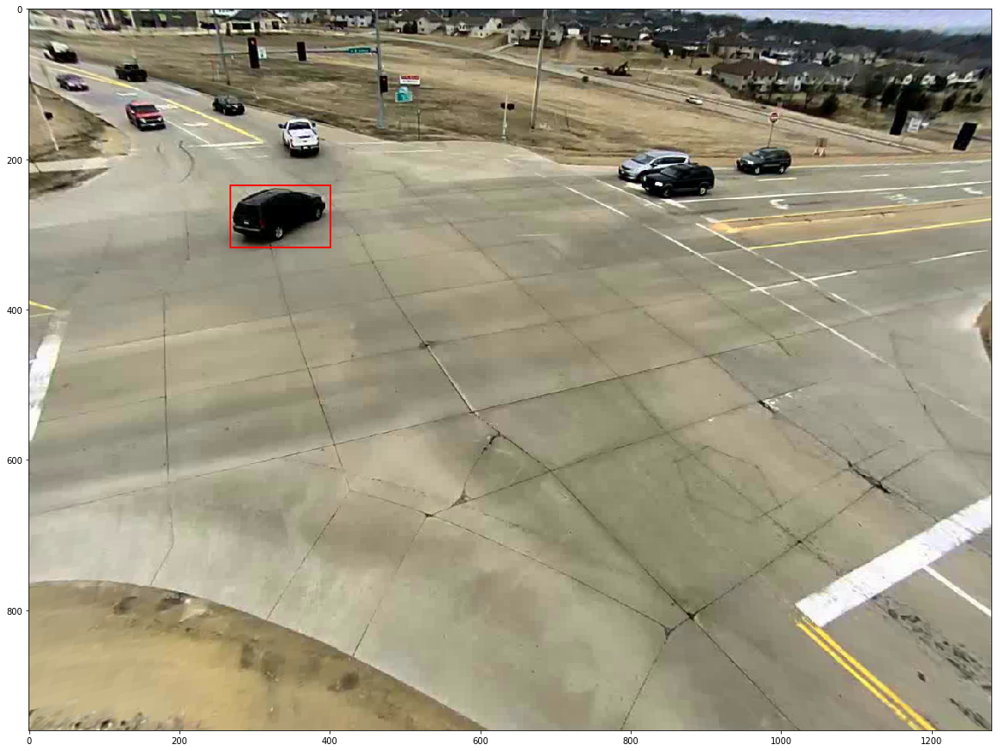

In [36]:
test = np.array([[[minc, minr], [maxc, maxr]]], dtype=np.float32)
undistort_pts = cv2.undistortPoints(test, camera_matrix, distort_coef, P=camera_matrix)

minc = undistort_pts[0][0][0]
minr = undistort_pts[0][0][1]
maxc = undistort_pts[0][1][0]
maxr = undistort_pts[0][1][1]

fig, ax = plt.subplots(figsize=(20,30))
ax.imshow(cv2.cvtColor(dst, cv2.COLOR_BGR2RGB))

rect = mpatches.Rectangle((minc, minr), maxc - minc + 1, maxr - minr + 1, fill=False, edgecolor='red', linewidth=2)
ax.add_patch(rect)


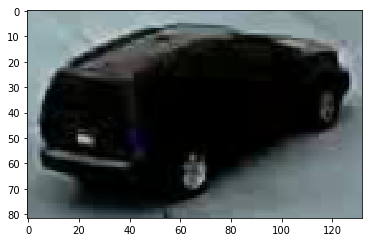

In [24]:
crop_image = dst[int(minr):int(maxr),int(minc):int(maxc)]
plt.imshow(crop_image)

# Print detections S01

{id_final={camera1=[id1_cam1, id2_cam1, id3_cam1...], camera2 = [id1_cam2, id2_cam2, ...]}}

In [9]:
colors = np.random.rand(500, 3)  # used only for display


In [38]:
with open(repo_path + '/week5/multitracksresultsS01_2.pkl', 'rb') as p:
    multitrack = pickle.load(p)
    
print(multitrack)

{1: defaultdict(<class 'list'>, {0: [4], 1: [0, 1, 2, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 21, 22, 23, 24, 25, 26, 28, 29, 30, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 53, 57, 62, 63], 2: [22, 41], 3: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10, 12, 13, 14, 15, 16, 17, 20, 22, 23, 25, 26, 27, 28, 29, 30, 32, 33, 34, 35, 36, 38]}), 2: defaultdict(<class 'list'>, {0: [6], 2: [6, 9, 16, 20], 4: [1, 5, 6]}), 3: defaultdict(<class 'list'>, {0: [8], 4: [0, 8, 12, 17]}), 4: defaultdict(<class 'list'>, {0: [10]}), 5: defaultdict(<class 'list'>, {0: [11], 1: [3, 67], 2: [17]}), 6: defaultdict(<class 'list'>, {0: [13], 2: [28, 51]}), 7: defaultdict(<class 'list'>, {0: [14], 3: [7, 18, 39, 43, 44, 45]}), 8: defaultdict(<class 'list'>, {0: [15]}), 9: defaultdict(<class 'list'>, {0: [16], 1: [68, 69], 3: [31, 40, 41], 4: [4]}), 10: defaultdict(<class 'list'>, {0: [17]}), 11: defaultdict(<class 'list'>, {0: [19]}), 12: defaultdict(<class 'list'>, {0: [2

In [48]:
with open(repo_path + '/week5/tracksS013.pkl', 'rb') as p:
    tracks = pickle.load(p)

print(tracks)

[
 Id=0, Detections=[
 frame=0, label=car, confidence=0.941, TopLeftXY=(1302,398), width=393, height=169, 
 frame=1, label=car, confidence=0.97, TopLeftXY=(1356,401), width=376, height=167, 
 frame=2, label=car, confidence=0.969, TopLeftXY=(1391,406), width=387, height=169, 
 frame=3, label=car, confidence=0.986, TopLeftXY=(1440,410), width=392, height=169, 
 frame=4, label=car, confidence=0.988, TopLeftXY=(1495,415), width=388, height=170, 
 frame=5, label=car, confidence=0.984, TopLeftXY=(1550,423), width=362, height=177], Time since update=2104, Hits=6, Hits streak=0, 
 Id=1, Detections=[
 frame=2, label=car, confidence=0.705, TopLeftXY=(674,304), width=113, height=148, 
 frame=3, label=car, confidence=0.691, TopLeftXY=(673,300), width=114, height=154, 
 frame=4, label=car, confidence=0.749, TopLeftXY=(672,304), width=115, height=150, 
 frame=5, label=car, confidence=0.768, TopLeftXY=(671,309), width=116, height=146, 
 frame=6, label=car, confidence=0.778, TopLeftXY=(669,310), width

In [40]:
for id in multitrack.keys():
    print(id)
    id_cams = multitrack[id][0]
    print(id_cams)
    if len(id_cams) > 1:
        continue
    for id_cams in id_cams:
        print(id_cam)
        track = [x for x in tracks if x.id == id_cam]
        #print(track)
        detection_in_frame = [x for x in track[0].detections if x.frame == n_frame]
        if detection_in_frame:
            print(track)
            print(detection_in_frame)



1
[4]
270
2
[6]
270
3
[8]
270
4
[10]
270
5
[11]
270
6
[13]
270
7
[14]
270
8
[15]
270
9
[16]
270
10
[17]
270
11
[19]
270
12
[20]
270
13
[21]
270
14
[22]
270
15
[23]
270
16
[24]
270
17
[25]
270
18
[26]
270
19
[28]
270
20
[29]
270
21
[30]
270
22
[31]
270
23
[32]
270
24
[33]
270
25
[34]
270
26
[35]
270
27
[38]
270
28
[42]
270
29
[43]
270
30
[44]
270
31
[45]
270
32
[48]
270
33
[54]
270
34
[58]
270
35
[61]
270
36
[62]
270
37
[63]
270
38
[64]
270
39
[72]
270
40
[73]
270
41
[74]
270
42
[76]
270
43
[80]
270
44
[82]
270
45
[83]
270
46
[84]
270
47
[86]
270
48
[92]
270
49
[97]
270
50
[101]
270
51
[102]
270
52
[103]
270
53
[107]
270
54
[108]
270
55
[110]
270
56
[111]
270
57
[113]
270
58
[114]
270
59
[116]
270
60
[120]
270
61
[122]
270
62
[124]
270
63
[125]
270
64
[126]
270
65
[127]
270
66
[128]
270
67
[129]
270
68
[130]
270
69
[131]
270
70
[133]
270
71
[134]
270
72
[135]
270
73
[137]
270
74
[138]
270
75
[141]
270
76
[147]
270
77
[148]
270
78
[149]
270
79
[150]
270
80
[152]
270
81
[154]
270
82
[155]

In [53]:
from utils.plotting import visualize_tracks, visualize_tracks_opencv

train_sequences = ['S01']      # Train with S01 and S04

for sequence in train_sequences:
    print(sequence)

    
    sequence_path = os.path.join(train_path, sequence)
    cameras = [f for f in os.listdir(sequence_path) if not f.startswith('.')]
    cameras.sort()
    
    for n, camera in enumerate(cameras):
        if camera != 'c004':
            continue
        print(camera)
        
        # Load video
        video_path = os.path.join(sequence_path, camera, 'vdo.avi')
        
        # Load tracks
        with open(repo_path + '/week5/tracksS01'+ str(n) +'.pkl', 'rb') as p:
            tracks = pickle.load(p)
        
        # Load detections
        detections_list = []
        for track in tracks:
            for detection in track.detections:
                detections_list.append(detection)
                    
        capture = cv2.VideoCapture(video_path)
        n_frame = 0
        pbar = tqdm(total=2140)

        while capture.isOpened():
            valid, image = capture.read()
            if not valid:
                break
              
            for id in multitrack.keys():
                print(id)
                id_cams = multitrack[id][0]
                print(id_cams)
                for id_cam in id_cams:
                    track = [x for x in tracks if x.id == id_cam]
                    if track:
                        detection_in_frame = [x for x in track[0].detections if x.frame == n_frame]
                        print(detection_in_frame)

                        if detection_in_frame:
                            ###### Save frames
                            print(detection_in_frame)
                            minc, minr, maxc, maxr = detection_in_frame[0].bbox
                            cv2.rectangle(image, (minc, minr), (maxc, maxr), colors[id]*255, 20)
                            cv2.putText(image, str(id), (minc, minr), cv2.FONT_HERSHEY_SIMPLEX, 4, colors[id]*255, 10, cv2.LINE_AA)

                            print(id)
                            print(colors[id]*255)

            
            image = cv2.resize(image, (0, 0), fx=0.25, fy=0.25)
            cv2.imwrite('out/frame_{}_{:04d}.png'.format(camera,n_frame), image, [int(cv2.IMWRITE_PNG_COMPRESSION), 4, int(cv2.IMWRITE_JPEG_QUALITY), 70])

            n_frame += 1


S01
c004


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[
 frame=30, label=car, confidence=0.402, TopLeftXY=(410,228), width=207, height=259]
[
 frame=30, label=car, confidence=0.402, TopLeftXY=(410,228), width=207, height=259]
2
[139.46225086 157.40601905  39.71610055]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]


[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[

66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[24

153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[
 frame=41, label=car, confidence=0.782, TopLeftXY=(665,327), width=123, height=135]
[
 frame=41, label=car, confidence=0.782, TopLeftXY=(665,327), width=123, height=135]
175
[188.49440164  77.17993986 154.67922919]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[
 frame=42, label=car, confidence=0.451, TopLeftXY=(383,251), width=236, height=245]
[
 frame=42, label=car, confidence=0.451, TopLeftXY=(383,251), width=236, height=245]
2
[139.46225086 157.40601905  39.71610055]
3
[8]
[
 frame=42, label=car, confidence=0.236, TopLeftXY=(17

[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]


1
[4]
[]
2
[6]
[
 frame=49, label=car, confidence=0.529, TopLeftXY=(343,251), width=241, height=270]
[
 frame=49, label=car, confidence=0.529, TopLeftXY=(343,251), width=241, height=270]
2
[139.46225086 157.40601905  39.71610055]
3
[8]
[]
4
[10]
[]
5
[11]
[
 frame=49, label=car, confidence=0.31, TopLeftXY=(186,860), width=472, height=199]
[
 frame=49, label=car, confidence=0.31, TopLeftXY=(186,860), width=472, height=199]
5
[239.99899262 146.51620388 107.83109092]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54


1
[4]
[]
2
[6]
[
 frame=53, label=car, confidence=0.854, TopLeftXY=(304,248), width=244, height=312]
[
 frame=53, label=car, confidence=0.854, TopLeftXY=(304,248), width=244, height=312]
2
[139.46225086 157.40601905  39.71610055]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]


1
[4]
[]
2
[6]
[
 frame=56, label=car, confidence=0.909, TopLeftXY=(293,247), width=244, height=328]
[
 frame=56, label=car, confidence=0.909, TopLeftXY=(293,247), width=244, height=328]
2
[139.46225086 157.40601905  39.71610055]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]


8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]


1
[4]
[]
2
[6]
[
 frame=62, label=car, confidence=0.899, TopLeftXY=(245,255), width=262, height=347]
[
 frame=62, label=car, confidence=0.899, TopLeftXY=(245,255), width=262, height=347]
2
[139.46225086 157.40601905  39.71610055]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[
 frame=62, label=car, confidence=0.84, TopLeftXY=(680,350), width=127, height=101]
[
 frame=62, label=car, confidence=0.84, TopLeftXY=(680,350), width=127, height=101]
6
[224.73771308 103.14989206 128.78787958]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54


12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[17

[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[

[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[
 frame=72, label=car, confidence=0.312, TopLeftXY=(458,616), width=314, height=336]
[
 frame=72, label=car, confidence=0.312, TopLeftXY=(458,616), width=314, height=336]
175
[188.49440164  77.17993986 154.67922919]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[
 frame=73, label=car, confidence=0.948, TopLeftXY=(124,285), width=362, height=422]
[
 frame=73, label=car, confidence=0.948, TopLeftXY=(124,285), width=362, height=422]
2
[139.46225086 157.40601905  39.71610055]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[
 frame=73, label=car, confidence=0.981, TopLeftXY=(65

[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[
 frame=75, label=car, confidence=0.225, TopLeftXY=(374,716), width=365, height=360]
[
 frame=75, label=car, confidence=0.225, TopLeftXY=(374,716), width=365, height=360]
175
[188.49440164  77.17993986 154.67922919]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[
 frame=76, label=car, confidence=0.88, TopLeftXY=(77,295), width=372, height=448]
[
 frame=76, label=car, confidence=0.88,

[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[
 frame=79, label=car, confidence=0.943, TopLeftXY=(22,304), width=368, height=499]
[
 frame=79, label=car, confidence=0.943, TopLeftXY=(22,304), width=368, height=499]
2
[139.46225086 157.40601905  39.71610055]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[
 frame=79, label=car, confidence=0.971, TopLeftXY=(626,450), width=168, height=175]
[
 frame=79, label=car, confidence=0.971, TopLeftXY=(626,450), width=168, height=175]
6
[224.73771308 103.14989206 128.78787958]
7
[14]
[]
8
[15]
[]
9
[16]
[
 frame=79, label=car, confidence=0.455, TopLeftXY=(271,924), width

1
[4]
[]
2
[6]
[
 frame=82, label=car, confidence=0.848, TopLeftXY=(0,347), width=337, height=531]
[
 frame=82, label=car, confidence=0.848, TopLeftXY=(0,347), width=337, height=531]
2
[139.46225086 157.40601905  39.71610055]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[
 frame=82, label=car, confidence=0.992, TopLeftXY=(604,494), width=198, height=184]
[
 frame=82, label=car, confidence=0.992, TopLeftXY=(604,494), width=198, height=184]
6
[224.73771308 103.14989206 128.78787958]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[1

[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[
 frame=89, label=car, confidence=0.923, TopLeftXY=(518,624), width=285, height=288]
[
 frame=89, label=car, confidence=0.923, TopLeftXY=(518,624), width=285, height=288]
6
[224.73771308 103.14989206 128.78787958]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[
 frame=89, label=car, confidence=0.849, TopLeftXY=(710,318), width=102, height=80]
[
 frame=89, label=car, confidence=0.849, TopLeftXY=(710,318), width=102, height=80]
10
[235.11618033  34.78635436 105.88578858]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[
 frame=92, label=car, confidence=0.959, TopLeftXY=(462,730), width=316, height=339]
[
 frame=92, label=car, confidence=0.959, TopLeftXY=(462,730), width=316, height=339]
6
[224.73771308 103.14989206 128.78787958]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[
 frame=92, label=car, confidence=0.748, TopLeftXY=(699,347), width=108, height=79]
[
 frame=92, label=car, confidence=0.748, TopLeftXY=(699,347), width=108, height=79]
10
[235.11618033  34.78635436 105.88578858]
11
[19]
[]
12
[20]
[
 frame=92, label=car, confidence=0.306, TopLeftXY=(19,844), width=118, height=223]
[
 frame=92, label=car, confidence=0.306, TopLeftXY=(19,844), width=118, height=223]
12
[162.48455139  53.67537918 232.04357395]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[

[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[
 frame=101, label=car, confidence=0.824, TopLeftXY=(653,423), width=138, height=132]
[
 frame=101, label=car, confidence=0.824, TopLeftXY=(653,423), width=138, height=132]
10
[235.11618033  34.78635436 105.88578858]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[
 frame=108, label=car, confidence=0.775, TopLeftXY=(553,553), width=213, height=221]
[
 frame=108, label=car, confidence=0.775, TopLeftXY=(553,553), width=213, height=221]
10
[235.11618033  34.78635436 105.88578858]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[
 frame=120, label=car, confidence=0.766, TopLeftXY=(586,344), width=115, height=95]
[
 frame=120, label=car, confidence=0.766, TopLeftXY=(586,344), width=115, height=95]
15
[  8.02661991  28.27201203 232.30032004]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]

[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[
 frame=124, label=car, confidence=0.935, TopLeftXY=(573,386), width=123, height=120]
[
 frame=124, label=car, confidence=0.935, TopLeftXY=(573,386), width=123, height=120]
15
[  8.02661991  28.27201203 232.30032004]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86

15
[  8.02661991  28.27201203 232.30032004]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[
 frame=130, label=car, confidence=0.543, TopLeftXY=(1604,570), width=310, height=237]
[
 frame=130, label=car, confidence=0.543, TopLeftXY=(1604,570), width=310, height=237]
19
[ 89.93867658  59.16808515 171.93317348]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[1

[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[

[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[
 frame=137, label=car, confidence=0.884, TopLeftXY=(1470,468), width=258, height=186]
[
 frame=137, label=car, confidence=0.884, TopLeftXY=(1470,468), width=258, height=186]
19
[ 89.93867658  59.16808515 171.93317348]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[
 frame=143, label=car, confidence=0.902, TopLeftXY=(1371,406), width=195, height=144]
[
 frame=143, label=car, confidence=0.902, TopLeftXY=(1371,406), width=195, height=144]
19
[ 89.93867658  59.16808515 171.93317348]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[
 frame=147, label=car, confidence=0.973, TopLeftXY=(1323,382), width=168, height=120]
[
 frame=147, label=car, confidence=0.973, TopLeftXY=(1323,382), width=168, height=120]
19
[ 89.93867658  59.16808515 171.93317348]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[
 frame=154, label=car, confidence=0.855, TopLeftXY=(1255,332), width=124, height=101]
[
 frame=154, label=car, confidence=0.855, TopLeftXY=(1255,332), width=124, height=101]
19
[ 89.93867658  59.16808515 171.93317348]
20
[29]
[]
21
[30]
[
 frame=154, label=car, confidence=0.282, TopLeftXY=(861,262), width=96, height=89]
[
 frame=154, label=car, confidence=0.282, TopLeftXY=(861,262), width=96, height=89]
21
[ 56.26453562 245.94238948  12.74989964]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[
 frame=157, label=car, confidence=0.826, TopLeftXY=(1223,309), width=126, height=98]
[
 frame=157, label=car, confidence=0.826, TopLeftXY=(1223,309), width=126, height=98]
19
[ 89.93867658  59.16808515 171.93317348]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[
 frame=157, label=car, confidence=0.21, TopLeftXY=(1754,475), width=161, height=182]
[
 frame=157, label=car, confidence=0.21, TopLeftXY=(1754,475), width=161, height=182]
23
[130.8512138  250.2608764   79.32667269]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[
 frame=161, label=car, confidence=0.763, TopLeftXY=(1189,291), width=111, height=92]
[
 frame=161, label=car, confidence=0.763, TopLeftXY=(1189,291), width=111, height=92]
19
[ 89.93867658  59.16808515 171.93317348]
20
[29]
[]
21
[30]
[
 frame=161, label=car, confidence=0.207, TopLeftXY=(860,275), width=111, height=104]
[
 frame=161, label=car, confidence=0.207, TopLeftXY=(860,275), width=111, height=104]
21
[ 56.26453562 245.94238948  12.74989964]
22
[31]
[]
23
[32]
[]
24
[33]
[
 frame=161, label=car, confidence=0.751, TopLeftXY=(1635,422), width=279, height=189]
[
 frame=161, label=car, confidence=0.751, TopLeftXY=(1635,422), width=279, height=189]
24
[158.60070437 246.31263472  71.29994605]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[
 frame=164, label=car, confidence=0.847, TopLeftXY=(1162,285), width=104, height=80]
[
 frame=164, label=car, confidence=0.847, TopLeftXY=(1162,285), width=104, height=80]
19
[ 89.93867658  59.16808515 171.93317348]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[
 frame=164, label=car, confidence=0.637, TopLeftXY=(1574,389), width=248, height=174]
[
 frame=164, label=car, confidence=0.637, TopLeftXY=(1574,389), width=248, height=174]
24
[158.60070437 246.31263472  71.29994605]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[
 frame=168, label=car, confidence=0.756, TopLeftXY=(862,296), width=114, height=97]
[
 frame=168, label=car, confidence=0.756, TopLeftXY=(862,296), width=114, height=97]
21
[ 56.26453562 245.94238948  12.74989964]
22
[31]
[]
23
[32]
[]
24
[33]
[
 frame=168, label=car, confidence=0.75, TopLeftXY=(1494,354), width=209, height=149]
[
 frame=168, label=car, confidence=0.75, TopLeftXY=(1494,354), width=209, height=149]
24
[158.60070437 246.31263472  71.29994605]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]


[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[
 frame=175, label=car, confidence=0.575, TopLeftXY=(1378,315), width=165, height=113]
[
 frame=175, label=car, confidence=0.575, TopLeftXY=(1378,315), width=165, height=113]
24
[158.60070437 246.31263472  71.29994605]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]

[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166


[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[
 frame=182, label=car, confidence=0.208, TopLeftXY=(1304,281), width=125, height=93]
[
 frame=182, label=car, confidence=0.208, TopLeftXY=(1304,281), width=125, height=93]
24
[158.60070437 246.31263472  71.29994605]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[1

[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[
 frame=189, label=car, confidence=0.239, TopLeftXY=(1240,259), width=101, height=75]
[
 frame=189, label=car, confidence=0.239, TopLeftXY=(1240,259), width=101, height=75]
24
[158.60070437 246.31263472  71.29994605]
25
[34]
[]
26
[35]
[
 frame=189, label=car, confidence=0.918, TopLeftXY=(1630,567), width=284, height=289]
[
 frame=189, label=car, confidence=0.918, TopLeftXY=(1630,567), width=284, height=289]
26
[32.14997403 21.21461434 84.65272333]
27
[38]
[]
28
[42]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[
 frame=195, label=car, confidence=0.321, TopLeftXY=(1381,399), width=230, height=168]
[
 frame=195, label=car, confidence=0.321, TopLeftXY=(1381,399), width=230, height=168]
175
[188.49440164  77.17993986 154.67922919]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[
 frame=227, label=car, confidence=0.967, TopLeftXY=(1501,361), width=150, height=100]
[
 frame=227, label=car, confidence=0.967, TopLeftXY=(1501,361), width=150, height=100]
27
[ 92.40902948 209.13495147 227.60646763]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[
 frame=230, label=car, confidence=0.758, TopLeftXY=(1423,323), width=125, height=99]
[
 frame=230, label=car, confidence=0.758, TopLeftXY=(1423,323), width=125, height=99]
27
[ 92.40902948 209.13495147 227.60646763]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
14

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]


[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[13

[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[
 frame=269, label=car, confidence=0.58, TopLeftXY=(1824,476), width=88, height=189]
[
 frame=269, label=car, confidence=0.58, TopLeftXY=(1824,476), width=88, height=189]
29
[100.86732597  13.01262537  50.39338908]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
1

[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[
 frame=295, label=car, confidence=0.822, TopLeftXY=(715,280), width=104, height=91]
[
 frame=295, label=car, confidence=0.822, TopLeftXY=(715,280), width=104, height=91]
32
[129.07281539  28.79972774 121.30651554]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]

[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[
 frame=305, label=car, confidence=0.936, TopLeftXY=(658,337), width=126, height=117]
[
 frame=305, label=car, confidence=0.936, TopLeftXY=(658,337), width=126, height=117]
32
[129.07281539  28.79972774 121.30651554]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[
 frame=311, la

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[
 frame=314, label=car, confidence=0.925, TopLeftXY=(573,419), width=190, height=187]
[
 frame=314, label=car, confidence=0.925, TopLeftXY=(573,419), width=190, height=187]
32
[129.07281539  28.79972774 121.30651554]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[
 frame=319, label=car, confidence=0.964, TopLeftXY=(451,368), width=126, height=99]
[

165
[51, 81]
[]
[]
166
[50, 93]
[
 frame=322, label=car, confidence=0.975, TopLeftXY=(384,417), width=149, height=116]
[
 frame=322, label=car, confidence=0.975, TopLeftXY=(384,417), width=149, height=116]
166
[172.30449149  79.85157207  38.92855243]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[
 frame=323, label=car, confidence=0.912, TopLeftXY=(388,658), width=327, height=405]
[
 fra

[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]


[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[

170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[

192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[
 frame=361, label=car, confidence=0.805, TopLeftXY=(724,274), width=89, height=75]
[
 frame=361, label=car, confidence=0.805, TopLeftXY=(724,274), width=89, height=75]
38
[215.00171598 186.98161835 116.22845839]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[

[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[23

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[
 frame=373, label=car, confidence=0.896, TopLeftXY=(645,371), width=143, height=128]
[
 frame=373, label=car, confidence=0.896, TopLeftXY=(645,371), width=143, height=128]
38
[215.00171598 186.98161835 116.22845839]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[
 frame=379, label=car, confidence=0.939, TopLeftXY=(550,492), width=200, height=195]
[
 frame=379, label=car, confidence=0.939, TopLeftXY=(550,492), width=200, height=195]
38
[215.00171598 186.98161835 116.22845839]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
8

148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
4

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[

194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[
 frame=429, label=car, confidence=0.939, TopLeftXY=(1624,404), width=225, height=145]
[
 frame=429, label=car, confidence=0.939, TopLeftXY=(1624,404), width=225, height=145]
40
[250.0304651   11.60835854 148.52105652]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[

88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[
 frame=437, label=car, confidence=0.756, TopLeftXY=(1367,308), width=133, height=85]
[
 frame=437, label=car, confidence=0.756, TopLeftXY=(1367,308), width=133, height=85]
40
[250.0304651   11.60835854 148.52105652]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87

50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]


[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151


[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99

192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[
 frame=465, label=car, confidence=0.408, TopLeftXY=(1830,515), width=85, height=150]
[
 frame=465, label=car, confidence=0.408, TopLeftXY=(1830,515), width=85, height=150]
42
[247.57336981 121.21329041 219.65801894]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]

181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[
 frame=479, label=car, confidence=0.687, TopLeftXY=(1336,289), width=108, height=92]
[
 frame=479, label=car, confidence=0.687, TopLeftXY=(1336,289), width=108, height=92]
179
[74.87370768 10.30517399 80.14027589]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]


[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
5

[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[1

157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[10

[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]

[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
4

147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]

171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[
 frame=591, label=car, confidence=0.996, TopLeftXY=(1348,434), width=360, height=117]
[
 frame=591, label=car, confidence=0.996, TopLeftXY=(1348,434), width=360, height=117]
43
[227.37257179  54.9169611  115.51145392]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[
 frame=597, label=car, confidence=0.999, TopLeftXY=(932,447), width=426, height=133]
[
 frame=597, label=car, confidence=0.999, TopLeftXY=(932,447), width=426, height=133]
43
[227.37257179  54.9169611  115.51145392]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[
 frame=603, label=car, confidence=0.999, TopLeftXY=(459,470), width=443, height=136]
[
 frame=603, label=car, confidence=0.999, TopLeftXY=(459,470), width=443, height=136]
43
[227.37257179  54.9169611  115.51145392]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[
 frame=609, label=car, confidence=0.995, TopLeftXY=(0,507), width=389, height=138]
[
 frame=609, label=car, confidence=0.995, TopLeftXY=(0,507), width=389, height=138]
43
[227.37257179  54.9169611  115.51145392]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[

[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[

[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[
 frame=629, label=car, confidence=0.922, TopLeftXY=(0,607), width=274, height=206]
[
 frame=629, label=car, confidence=0.922, TopLeftXY=(0,607), width=274, height=206]
44
[ 98.84530129 120.45075004 241.07106813]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[

[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[

193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[
 frame=636, label=car, confidence=0.215, TopLeftXY=(208,597), width=491, height=210]
[
 frame=636, label=car, confidence=0.215, TopLeftXY=(208,597), width=491, height=210]
44
[ 98.84530129 120.45075004 241.07106813]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[13

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[
 frame=639, label=car, confidence=0.976, TopLeftXY=(389,587), width=528, height=206]
[
 frame=639, label=car, confidence=0.976, TopLeftXY=(389,587), width=528, height=206]
44
[ 98.84530129 120.45075004 241.07106813]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[
 frame=642, label=car, confidence=0.997, TopLeftXY=(1501,340), width=212, height=89]
[
 frame=642, label=car, confidence=0.997, TopLeftXY=(1501,340), width=212, height=89]
179
[74.87370768 10.30517399 80.14027589]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[
 frame=643, label=car, confidence=0.993, TopLeftXY=(682,555), width=525, height=215]
[
 frame=643, label=car, confid

70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149

[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[
 frame=649, label=car, confidence=0.983, TopLeftXY=(1358,313), width=157, height=85]
[
 frame=649, label=car, confidence=0.983, TopLeftXY=(1358,313), width=157, height=85]
179
[74.87370768 10.30517399 80.14027589]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[
 frame=653, label=car, confidence=0.987, TopLeftXY=(1425,524), width=447, height=199]
[
 frame=653, label=car, confidence=0.987, TopLeftXY=(1425,524), width=447, height=199]
44
[ 98.84530129 120.45075004 241.07106813]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[
 frame=657, label=car, confidence=0.913, TopLeftXY=(1680,521), width=234, height=184]
[
 frame=657, label=car, confidence=0.913, TopLeftXY=(1680,521), width=234, height=184]
48
[ 62.11037044 202.44368596 177.44622283]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[2

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[
 frame=674, label=car, confidence=0.75, TopLeftXY=(1644,493), width=268, height=205]
[
 frame=674, label=car, confidence=0.75, TopLeftXY=(1644,493), width=268, height=205]
48
[ 62.11037044 202.44368596 177.44622283]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[
 frame=712, label=car, confidence=0.206, TopLeftXY=(1797,553), width=113, height=126]
[
 frame=712, label=car, confidence=0.206, TopLeftXY=(1797,553), width=113, height=126]
50
[239.21884717 178.56490038 118.95885506]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[11

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]


[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274

[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
5

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266

173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[
 frame=807, label=car, confidence=0.272, TopLeftXY=(1568,337), width=295, height=106]
[
 frame=807, label=car, confidence=

[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[

[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163


177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[
 frame=841, label=car, confidence=0.344, TopLeftXY=(876,324), width=151, height=141]
[
 frame=841, label=car, confidence=0.344, TopLeftXY=(876,324), width=151, height=141]
57
[185.27046857 236.

123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[
 frame=852, label=car, confidence=0.437, TopLeftXY=(896,350), width=265, height=150]
[
 frame=852, label=car, confidence=0.437, TopLeftXY=(896,350), width=265, height=150]
57
[185.27046857 236.14984052 104.65184815]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[

[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[
 frame=862, label=car, confidence=0.565, TopLeftXY=(1069,374), width=414, height=173]
[
 frame=862, label=car, confidence=0.565, TopLeftXY=(1069,374), width=414, height=173]
57
[185.27046857 236.14984052 104.65184815]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159

[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[
 frame=871, label=car, confidence=0.64, TopLeftXY=(1424,413), width=461, height=178]
[
 frame=871, label=car, confidence=0.64, TopLeftXY=(1424,413), width=461, height=178]
57
[185.27046857 236.14984052 104.65184815]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[
 frame=875, label=car, confidence=0.969, TopLeftXY=(1625,414), width=285, height=161]
[
 frame=875, label=car, confidence=0.969, TopLeftXY=(1625,414), width=285, height=161]
57
[185.27046857 236.14984052 104.65184815]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[19

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[
 frame=923, label=car, confidence=0.88, TopLeftXY=(1365,908), width=543, height=160]
[
 frame=923, label=car, confidence=0.88, TopLeftXY=(1365,908), width=543, height=160]
63
[201.70614786 252.66487192 117.52046411]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[
 frame=927, label=car, confidence=0.993, TopLeftXY=(1166,782), width=525, height=290]
[
 frame=927, label=car, confidence=0.993, TopLeftXY=(1166,782), width=525, height=290]
64
[ 21.94710489  24.01373204 214.97028035]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[

[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]

166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[12

[
 frame=939, label=car, confidence=0.997, TopLeftXY=(489,579), width=437, height=219]
64
[ 21.94710489  24.01373204 214.97028035]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[23

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[
 frame=946, label=car, confidence=0.998, TopLeftXY=(107,535), width=382, height=183]
[
 frame=946, label=car, confidence=0.998, TopLeftXY=(107,535), width=382, height=183]
64
[ 21.94710489  24.01373204 214.97028035]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[13

[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
3

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[
 frame=953, label=car, confidence=0.771, TopLeftXY=(1084,672), width=706, height=401]
[
 frame=953, label=car, confidence=0.771, TopLeftXY=(1084,672), width=706, height=401]
69
[117.81492645 158.2141577   11.53536315]
70
[133]
[]
71
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[
 frame=959, label=car, confidence=0.544, TopLeftXY=(817,598), width=642, height=373]
[
 frame=959, label=car, confidence=0.544, TopLeftXY=(817,598), width=642, height=373]
69
[117.81492645 158.2141577   11.53536315]
70
[133]
[]
71
[13

[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[
 frame=969, label=car, confidence=0.504, TopLeftXY=(283,538), width=596, height=260]
[
 frame=969, label=car, confidence=0.504, TopLeftXY=(283,538), width=596, height=260]
69
[117.81492645 158.2141577   11.53536315]
70
[133]
[]
71
[13

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[
 frame=973, label=car, confidence=0.82, TopLeftXY=(69,512), width=554, height=252]
[
 frame=973, label=car, confidence=0.82, TopLeftXY=(69,512), width=554, height=252]
69
[117.81492645 158.2141577   11.53536315]
70
[133]
[]
71
[134]
[

[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
18

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[
 frame=980, label=car, confidence=0.893, TopLeftXY=(5,553), width=203, height=167]
[
 frame=980, label=car, confidence=0.893, TopLeftXY=(5,553), width=203, height=167]
69
[117.81492645 158.2141577   11.53536315]
70
[133]
[]
71
[134]
[

[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[
 frame=987, label=car, confidence=0.969, TopLeftXY=(1533,507), width=278, height=189]
[
 frame=987, label=car, confidence=0.969, TopLeftXY=(1533,507), width=278, height=189]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[
 frame=994, label=car, confidence=0.965, TopLeftXY=(1413,427), width=201, height=148]
[
 frame=994, label=car, confidence=0.965, TopLeftXY=(1413,427), width=201, height=148]


100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[
 frame=1001, label=car, confidence=0.971, TopLeftXY=(1318,367), width=156, height=121]
[
 frame=1001, label=car, confidence=0.971, TopLeftXY=(1318,367), width=156, height=121

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[
 frame=1007, label=car, confidence=0.719, TopLeftXY=(1268,333), width=115, height=101]
[
 frame=1007, label=car, confidence=0.719, TopLeftXY=(1268,333), width=115, height=101

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[
 frame=1014, label=car, confidence=0.712, TopLeftXY=(1196,290), width=105, height=91]
[
 frame=1014, label=car, confidence=0.712, TopLeftXY=(1196,290), width=105, height=91]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161

[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87

190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]

[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84


[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155

16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[
 frame=1083, label=car, confidence=0.628, TopLeftXY=(733,257), width=84, height=80]
[
 frame=1083, label=car, confidence=0.628, TopLeftXY=(733,257), w

[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[

192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[
 frame=1090, label=car, confidence=0.689, TopLeftXY=(704,276), width=107, height=103]
[
 frame=1090, label=car, confide

[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166


178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[
 frame=1100, label=car, confidence=0.398, TopLeftXY=(656,334), width=142, height=145]
[
 frame=1100, label=car, confidence=0.398, TopLeftXY=(656,334),

[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[
 frame=1107, label=car, confidence=0.432, TopLeftXY=(591,408), width=196, height=200]
[
 frame=1107, label=car, confidence=0.432, TopLeftXY=(591,408),

[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[
 frame=1110, label=car, confidence=0.728, TopLeftXY=(541,445), width=238, height=259]
[
 frame=1110, label=car, confidence=0.728, TopLeftXY=(541,445), width=238, height=259]
76
[ 23.90377155 228.66329031 194.07151926]
77
[148]
[]
78
[149]
[]
79
[150]
[
 frame=1110, label=car, confidence=0.926, TopLeftXY=(1311,262), width=144, height=103]
[
 frame=1110, label=car, confidence=0.926, TopLeftXY=(1311,262), width=144, height=103]
79
[ 91.36487682  94.78753489 132.28687552]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[
 frame=1114, label=car, confidence=0.494, TopLeftXY=(463,558), width=303, height=361]
[
 frame=1114, label=car, confidence=0.494, TopLeftXY=(463,558),

76
[ 23.90377155 228.66329031 194.07151926]
77
[148]
[]
78
[149]
[]
79
[150]
[
 frame=1117, label=car, confidence=0.617, TopLeftXY=(1220,237), width=109, height=82]
[
 frame=1117, label=car, confidence=0.617, TopLeftXY=(1220,237), width=109, height=82]
79
[ 91.36487682  94.78753489 132.28687552]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[
 frame=1128, label=car, confidence=0.849, 

111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[
 frame=1135, label=car, confidence=0.895, 

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[
 frame=1142, label=car, confidence=0.885, 

87
[ 76.58551566 117.96258104 221.32318504]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]

189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
8

187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[1

180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[

[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[
 frame=1166, label=car, confidence=0.807, TopLeftXY=(1512,349), width=217, height=151]
[
 frame=1166, label=car, confidence=0.807, TopLeftXY=(1512,349), width=217, height=151]
90
[47.12648588 79.47974083 43.70884834]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[2

175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68


72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[
 frame=1173, label=car, confidence=0.537, TopLeftXY=(1359,286), width=141, height=109]
[
 frame=1173, label=car, confidence=0.537, TopLeftXY=(1359,286), width=141, height=109]
90
[47.12648588 79.47974083 43.70884834]
91
[165]
[]
92
[166]
[
 frame=1173, label=car, confidence=0.47, TopLeftXY=(1731,455), width=188, height=164]
[
 frame=1173, label=car, confidence=0.47, TopLeftXY=(1731,455), width=188, height=164]
92
[ 72.98100728  43.96550371 196.42651513]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
3

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[16

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[12

[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
6

71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
15

[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111

[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[
 frame=1262, label=car, confidence=0.836, TopLeftXY=(1466,346), width=138, height=98]
[
 frame=1262, label=car, confidence=0.836, TopLeftXY=(1466,346), width=138, height=98]
94
[195.41960453 117.17525395  15.05472999]
95
[169]
[]
96
[170]
[]
97
[171]
[
 frame=1262, label=car, confidence=0.917, TopLeftXY=(1469,463), width=223, height=160]
[
 frame=1262, label=car, confidence=0.917, TopLeftXY=(1469,463), width=223, height=160]
97
[ 50.23491306 181.04493845 110.60934184]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]


146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]


[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[
 frame=1269, label=car, confidence=0.798, TopLeftXY=(1286,343), width=130, height=100]
[
 frame=1269, label=car, confidence=0.798, TopLeftXY=(1286,343), width=130, height=100]
97
[ 50.23491306 181.04493845 110.60934184]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29

128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[2

[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[

[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[

[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[

[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[
 frame=1321, label=car, confidence=0.834, TopLeftXY=(567,438), width=198, height=189]
[
 frame=1321, label=car, confidence=0.834, TopLeftXY=(567,438), width=198, height=189]
101
[244.74126358 224.08169218 231.29674824]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[

[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]


174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[7

144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]


12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[17

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2


[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]

[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
1

[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98


103
[178]
[]
104
[180]
[
 frame=1389, label=car, confidence=0.205, TopLeftXY=(1411,333), width=158, height=105]
[
 frame=1389, label=car, confidence=0.205, TopLeftXY=(1411,333), width=158, height=105]
104
[125.08309038  35.53273424 149.74645691]
105
[181]
[
 frame=1389, label=car, confidence=0.98, TopLeftXY=(11,681), width=295, height=350]
[
 frame=1389, label=car, confidence=0.98, TopLeftXY=(11,681), width=295, height=350]
105
[237.64533736 106.37469147  48.89510662]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[25

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[
 frame=1396, label=car, confidence=0.754, TopLeftXY=(1282,280), width=105, height=77]
[
 frame=1396, label=car, confidence=0.754, TopLeftXY=(1282,280), width=105, height=77]
104
[125.08309038  35.53273424 149.74645691]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]

189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
8

187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[1

87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[
 frame=1410, label=car, confidence=0.997, TopLeftXY=(1647,448), width=212, height=123]
[
 frame=1410, label=car, confidence=0.997, TopLeftXY=(1647,448), width=212, height=123]
107
[ 72.02308265 138.69781243 108.9838438 ]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]


[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[

[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[
 frame=1417, label=car, confidence=0.837, TopLeftXY=(1440,345), width=131, height=89]
[
 frame=1417, label=car, confidence=0.837, TopLeftXY=(1440,345), width=131, height=89]
107
[ 72.02308265 138.69781243 108.9838438 ]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
1

172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[12

[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
6

[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[1

166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[12

[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]

[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]


46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[

81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]


175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68


[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[
 frame=1538, label=car, confidence=0.999, TopLeftXY=(494,491), width=428, height=143]
[
 frame=1538, label=car, confidence=0.999, TopLeftXY=(494,491), width=428, height=143]
109
[140.925778    19.94447409 104.88971336]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[
 frame=1548, label=car, confidence=0.996, TopLeftXY=(981,424), width=268, height=113]
[
 frame=1548, label=car, confidence=0.996, TopLeftXY=(981,424), width=268, height=113]
109
[140.925778    19.94447409 104.88971336]
110
[189]
[]
111
[190]
[
 frame=1548, label=car, confidence=0.7, TopLeftXY=(551,301), width=92, height=78]
[
 frame=1548, label=car, confidence=0.7, TopLeftXY=(551,301), width=92, height=78]
111
[204.51734858 228.99957537 239.37624353]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
11

155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[
 frame=1561, label=car, confidence=0.85, TopLeftXY=(1273,352), width=131, height=94]
[
 frame=1561, label=car, confidence=0.85, TopLeftXY=(1273,352), width=131, height=94]
109
[140.925778    19.94447409 104.88971336]
110
[189]
[]
111
[190]
[
 frame=1561, label=car, confidence=0.772, TopLeftXY=(503,321), width=114, height=94]
[
 frame=1561, label=car, confidence=0.772, TopLeftXY=(503,321), width=114, height=94]
111
[204.5173485

[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
5

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[10

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[
 frame=1689, label=car, confidence=0.995, TopLeftXY=(1499,441), width=317, height=118]
[
 frame=1689, label=car, confidence=0.995, TopLeftXY=(1499,441), width=317, height=118]
119
[ 51.78410705 146.02676908 236.66922111]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]


[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
6

[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[1

166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[12

[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]

162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]

117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[
 frame=1748, label=car, confidence=0.977, TopLeftXY=(3,463), width=339, height=178]
[
 frame=1748, label=car, confidence=0.977, TopLeftXY=(3,463), width=339, height=178]
121
[ 53.6901366   27.86278898 148.0346203 ]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]

[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]


[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
5

151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]

[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[
 frame=1773, label=car, confidence=0.783, TopLeftXY=(571,281), width=94, height=82]
[
 frame=1773, label=car, confidence=0.

[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[
 frame=1797, label=car, confidence=0.999, TopLeftXY=(1025,431), width=360, height=150]
[
 frame=1797, label=car, confidence=0.999, TopLeftXY=(1025,431), width=360, height=150]
125
[  0.96704101 151.24155112 253.71312826]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[
 frame=1804, label=car, confidence=0.999, TopLeftXY=(313,468), width=368, height=160]
[
 frame=1804, label=car, confidence=0.999, TopLeftXY=(313,468), width=368, height=160]
125
[  0.96704101 151.24155112 253.71312826]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]


[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[
 frame=1818, label=car, confidence=0.992, TopLeftXY=(1570,433), width=304, height=110]
[
 frame=1818, label=car, confidence=0.992, TopLeftXY=(1570,433), width=304, height=110]
128
[ 37.45603364 249.00022916 129.81033724]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[

183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
8

[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[
 frame=1825, label=car, confidence=0.999, TopLeftXY=(1039,445), width=371, height=129]
[
 frame=1825, label=car, confidence=0.999, TopLeftXY=(1039,445), width=371, height=129]
128
[ 37.45603364 249.00022916 129.81033724]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]


[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[7

[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]

144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[3

133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[

[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[

[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[
 frame=1926, label=car, confidence=0.538, TopLeftXY=(1523,955), width=396, height=122]
[
 frame=1926, label=car, confidence=0.538, TopLeftXY=(1523,955), width=396, height=122]
133
[106.11721588 111.86511391 191.69086334]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[
 frame=1940, label=car, confidence=0.974, TopLeftXY=(1206,756), width=552, height=319]
[
 frame=1940, label=car, confidence=0.974, TopLeftXY=(1206,756), width=552, height=319]
134
[ 37.95892313 136.59403536 188.77490363]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[
 frame=1947, label=car, confidence=0.978, TopLeftXY=(923,674), width=536, height=297]
[
 frame=1947, label=car, confidence=0.978, TopLeftXY=(923,674), width=536, height=297]
134
[ 37.95892313 136.59403536 188.77490363]
135
[235]
[
 frame=1947, label=car, confidence=0.376, TopLeftXY=(876,297), width=121, height=127]
[
 frame=1947, label=car, confidence=0.376, TopLeftXY=(876,297), width=121, height=127]
135
[66.64482506 36.47094294 48.29813348]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[

[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]


[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[
 frame=1961, label=car, confidence=0.993, TopLeftXY=(164,570), width=455, height=211]
[
 frame=1961, label=car, confidence=0.993, TopLeftXY=(164,570), width=455, height=211]
134
[ 37.95892313 136.59403

152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[
 frame=1964, label=car, confidence=0.518, TopLeftXY=(884,300), width=111, height=103]
[
 frame=1964, label=car, confidence=0.518, TopLeftXY=(884,300), width=111, height=103]
169
[250.57873708 148.49951238  71.22089429]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]


1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[
 frame=1978, label=car, confidence=0.999, TopLeftXY=(1547,427), width=369, height=156]
[
 frame=1978, label=car, confidence=0.999, TopLeftXY=(1547,427), width=369, height=156]
135
[66.64482506 36.47094294 48.29813348]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[
 frame=1978, label=car, confidence=0.965, TopLeftXY=(1033,701), width=497, height=316]
[
 frame=1978, label=car, confidence=0.965, TopLeftXY=(1033,701), width=497, height=316]
144
[ 99.18233137 235.78027464 200.89749832]
145
[249]
[]
1

[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83

80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[
 frame=1985, label=car, confidence=0.981, TopLeftXY=(689,600), width=448, height=245]
[
 frame=1985, label=car, confidence=0.981, TopLeftXY=(689,600), width=448, height=245]
14

[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[
 frame=1988, label=car, confidence=0.984, TopLeftXY=(1011,366), width=269, height=136]
[
 frame=1988, label=car, confidence=0.984, TopLeftXY=(1011,366), width=269, height=136]
169
[250.57873708 148.49951238  71.22089429]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[1

[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[
 frame=2017, label=car, confidence=0.999, TopLeftXY

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17


[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15


[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[2

122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[
 frame=2056, label=car, confidence=0.857, TopLeftXY=(871,254), width=97, height=79]
[
 frame=2056, label=car, confidence=0.857, TopLeftXY=(871,254), width=97, hei

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[]
179
[77, 88, 95, 96, 98]
[]
[]
[]
[]
[]
180
[]
181
[]
182
[]
183
[]
184
[]
185
[]
186
[]
187
[264]
[]
188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]


[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[
 frame=2071, label=car, confidence=0.886, TopLeftXY=(648,347), width=141, height=131]
[
 frame=2071, label=car, confidence=0.886, TopLeftXY=(648,347), width=141, height=131]
155
[143.8180351  175.4059053  241.90460711]
156
[266]
[
 frame=2071, label=car, confidence=0.823, TopLeftXY=(461,352), width=123, height=97]
[
 frame=2071, label=car, confidence=0.823, TopLeftXY=(461,352), width=123, height=97]
156
[53.60252445 78.09593708 35.16147347]
157
[267]
[]
158
[270]
[]
159
[271]
[]
160
[272]
[]
161
[273]
162
[274]
163
[275]
164
[]
165
[51, 81]
[]
[]
166
[50, 93]
[]
[]
167
[]
168
[]
169
[240]
[]
170
[]
171
[]
172
[]
173
[]
174
[]
175
[0, 3, 5, 7, 36, 37, 39, 40]
[]
[]
[]
[]
[]
[]
[]
[]
176
[41]
[]
177
[49]
[]
178
[66]
[

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

188
[]
189
[]
190
[]
191
[]
192
[]
193
[]
194
[]
195
[276]
1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[15

80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[163]
[]
90
[164]
[]
91
[165]
[]
92
[166]
[]
93
[167]
[]
94
[168]
[]
95
[169]
[]
96
[170]
[]
97
[171]
[]
98
[172]
[]
99
[173]
[]
100
[175]
[]
101
[176]
[]
102
[177]
[]
103
[178]
[]
104
[180]
[]
105
[181]
[]
106
[182]
[]
107
[183]
[]
108
[185]
[]
109
[188]
[]
110
[189]
[]
111
[190]
[]
112
[191]
[]
113
[192]
[]
114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[
 frame=2096, label=car, confidenc

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

1
[4]
[]
2
[6]
[]
3
[8]
[]
4
[10]
[]
5
[11]
[]
6
[13]
[]
7
[14]
[]
8
[15]
[]
9
[16]
[]
10
[17]
[]
11
[19]
[]
12
[20]
[]
13
[21]
[]
14
[22]
[]
15
[23]
[]
16
[24]
[]
17
[25]
[]
18
[26]
[]
19
[28]
[]
20
[29]
[]
21
[30]
[]
22
[31]
[]
23
[32]
[]
24
[33]
[]
25
[34]
[]
26
[35]
[]
27
[38]
[]
28
[42]
[]
29
[43]
[]
30
[44]
[]
31
[45]
[]
32
[48]
[]
33
[54]
[]
34
[58]
[]
35
[61]
[]
36
[62]
[]
37
[63]
[]
38
[64]
[]
39
[72]
[]
40
[73]
[]
41
[74]
[]
42
[76]
[]
43
[80]
[]
44
[82]
[]
45
[83]
[]
46
[84]
[]
47
[86]
[]
48
[92]
[]
49
[97]
[]
50
[101]
[]
51
[102]
[]
52
[103]
[]
53
[107]
[]
54
[108]
[]
55
[110]
[]
56
[111]
[]
57
[113]
[]
58
[114]
[]
59
[116]
[]
60
[120]
[]
61
[122]
[]
62
[124]
[]
63
[125]
[]
64
[126]
[]
65
[127]
[]
66
[128]
[]
67
[129]
[]
68
[130]
[]
69
[131]
[]
70
[133]
[]
71
[134]
[]
72
[135]
[]
73
[137]
[]
74
[138]
[]
75
[141]
[]
76
[147]
[]
77
[148]
[]
78
[149]
[]
79
[150]
[]
80
[152]
[]
81
[154]
[]
82
[155]
[]
83
[156]
[]
84
[157]
[]
85
[158]
[]
86
[159]
[]
87
[160]
[]
88
[161]
[]
89
[1

114
[194]
[]
115
[195]
[]
116
[196]
[]
117
[197]
[]
118
[198]
[]
119
[199]
[]
120
[204]
[]
121
[210]
[]
122
[213]
[]
123
[214]
[]
124
[215]
[]
125
[216]
[]
126
[218]
[]
127
[220]
[]
128
[221]
[]
129
[225]
[]
130
[226]
[]
131
[227]
[]
132
[228]
[]
133
[233]
[]
134
[234]
[]
135
[235]
[]
136
[236]
[]
137
[237]
[]
138
[238]
[]
139
[241]
[]
140
[242]
[]
141
[243]
[]
142
[244]
[]
143
[245]
[]
144
[248]
[]
145
[249]
[]
146
[250]
[]
147
[252]
[]
148
[254]
[]
149
[257]
[]
150
[258]
[]
151
[259]
[]
152
[261]
[]
153
[262]
[]
154
[263]
[]
155
[265]
[]
156
[266]
[
 frame=2107, label=car, confidence=0.994, TopLeftXY=(52,592), width=278, height=213]
[
 frame=2107, label=car, confidence=0.994, TopLeftXY=(52,592), width=278, height=213]
156
[53.60252445 78.09593708 35.16147347]
157
[267]
[
 frame=2107, label=car, confidence=0.958, TopLeftXY=(654,354), width=142, height=129]
[
 frame=2107, label=car, confidence=0.958, TopLeftXY=(654,354), width=142, height=129]
157
[123.76307223  44.84320939  28.7321499

In [58]:
from utils.plotting import visualize_tracks, visualize_tracks_opencv

train_sequences = ['S01']      # Train with S01 and S04

for sequence in train_sequences:
    print(sequence)

    
    sequence_path = os.path.join(train_path, sequence)
    cameras = [f for f in os.listdir(sequence_path) if not f.startswith('.')]
    cameras.sort()
    
    for n, camera in enumerate(cameras):
        if camera != 'c005':
            continue
        print(camera)
        
        # Load video
        video_path = os.path.join(sequence_path, camera, 'vdo.avi')
        
        # Load tracks
        with open(repo_path + '/week5/tracksS01'+ str(n) +'.pkl', 'rb') as p:
            tracks = pickle.load(p)
        
        # Load detections
        detections_list = []
        for track in tracks:
            for detection in track.detections:
                detections_list.append(detection)
                    
        capture = cv2.VideoCapture(video_path)
        n_frame = 0
        pbar = tqdm(total=2140)

        while capture.isOpened():
            valid, image = capture.read()
            if not valid:
                break
            image = cv2.undistort(image, camera_matrix, distort_coef, None, None)

              
            for id in multitrack.keys():
                id_cams = multitrack[id][0]
                for id_cam in id_cams:
                    track = [x for x in tracks if x.id == id_cam]
                    if track:
                        detection_in_frame = [x for x in track[0].detections if x.frame == n_frame]
                        #print(detection_in_frame)

                        if detection_in_frame:
                            ###### Save frames
                            minc, minr, maxc, maxr = detection_in_frame[0].bbox
                            
                            test = np.array([[[minc, minr], [maxc, maxr]]], dtype=np.float32)
                            undistort_pts = cv2.undistortPoints(test, camera_matrix, distort_coef, P=camera_matrix)

                            minc = undistort_pts[0][0][0]
                            minr = undistort_pts[0][0][1]
                            maxc = undistort_pts[0][1][0]
                            maxr = undistort_pts[0][1][1]
                            
                            cv2.rectangle(image, (minc, minr), (maxc, maxr), colors[id]*255, 20)
                            cv2.putText(image, str(id), (minc, minr), cv2.FONT_HERSHEY_SIMPLEX, 4, colors[id]*255, 10, cv2.LINE_AA)

            
            image = cv2.resize(image, (0, 0), fx=0.25, fy=0.25)
            cv2.imwrite('out/frame_{}_{:04d}.png'.format(camera,n_frame), image, [int(cv2.IMWRITE_PNG_COMPRESSION), 4, int(cv2.IMWRITE_JPEG_QUALITY), 70])

            n_frame += 1


S01
c005
